In [1]:
%reload_ext nb_black

<IPython.core.display.Javascript object>

### Imports

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from tqdm.notebook import tqdm

from scipy import stats

from sklearn.preprocessing import StandardScaler

from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans, MeanShift, estimate_bandwidth
from sklearn.metrics import silhouette_score
from sklearn.cluster import DBSCAN

import seaborn as sns
import matplotlib.pyplot as plt

import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt

%matplotlib inline

<IPython.core.display.Javascript object>

### Dataset Overview:

The data has the following columns:
* Date/Time : The date and time of the Uber pickup
* Lat : The latitude of the Uber pickup
* Lon : The longitude of the Uber pickup
* Base : The TLC base company code affiliated with the Uber pickup

The Base codes are for the following Uber bases:

* B02512 : Unter  
* B02598 : Hinter
* B02617 : Weiter
* B02682 : Schmecken
* B02764 : Danach-NY
* B02765 : Grun
* B02835 : Dreist
* B02836 : Drinnen

## Goal: optimize pickups using unsupervized learning methods

### Loading and Cleaning Data

In [3]:
uber_apr = pd.read_csv("data/uber-raw-data-apr14.csv")
uber_apr.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


<IPython.core.display.Javascript object>

In [4]:
uber_apr.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 564516 entries, 0 to 564515
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Date/Time  564516 non-null  object 
 1   Lat        564516 non-null  float64
 2   Lon        564516 non-null  float64
 3   Base       564516 non-null  object 
dtypes: float64(2), object(2)
memory usage: 17.2+ MB


<IPython.core.display.Javascript object>

In [5]:
uber_apr["Base"].value_counts()

B02682    227808
B02598    183263
B02617    108001
B02512     35536
B02764      9908
Name: Base, dtype: int64

<IPython.core.display.Javascript object>

In [6]:
# Replace Base codes with Base Names
uber_apr = uber_apr.replace(
    {
        "Base": {
            "B02682": "Schmecken",
            "B02598": "Hinter",
            "B02617": "Weiter",
            "B02512": "Unter",
            "B02764": "Danach-NY",
        }
    }
)

<IPython.core.display.Javascript object>

In [7]:
# Changing the datetime object
uber_apr["Date/Time"] = pd.to_datetime(uber_apr["Date/Time"])

<IPython.core.display.Javascript object>

In [8]:
# Extracting Date/Time to generate new columns as Weekday, Day, Hour and Minute
uber_apr["month_day"] = uber_apr["Date/Time"].dt.day
uber_apr["weekday"] = uber_apr["Date/Time"].dt.day_name()
uber_apr["week_day"] = uber_apr["Date/Time"].dt.dayofweek
uber_apr["hour"] = uber_apr["Date/Time"].dt.hour
uber_apr["minute"] = uber_apr["Date/Time"].dt.minute

<IPython.core.display.Javascript object>

In [9]:
# df = df.drop(columns=["Date/Time"])
# no need to drop the Date/Time column
# checking the database
uber_apr.head()

,Date/Time,Lat,Lon,Base,month_day,weekday,week_day,hour,minute
0,2014-04-01 00:11:00,40.7690,-73.9549,Unter,1,Tuesday,1,0,11
1,2014-04-01 00:17:00,40.7267,-74.0345,Unter,1,Tuesday,1,0,17
2,2014-04-01 00:21:00,40.7316,-73.9873,Unter,1,Tuesday,1,0,21
3,2014-04-01 00:28:00,40.7588,-73.9776,Unter,1,Tuesday,1,0,28
4,2014-04-01 00:33:00,40.7594,-73.9722,Unter,1,Tuesday,1,0,33


<IPython.core.display.Javascript object>

In [10]:
uber_apr.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 564516 entries, 0 to 564515
Data columns (total 9 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Date/Time  564516 non-null  datetime64[ns]
 1   Lat        564516 non-null  float64       
 2   Lon        564516 non-null  float64       
 3   Base       564516 non-null  object        
 4   month_day  564516 non-null  int64         
 5   weekday    564516 non-null  object        
 6   week_day   564516 non-null  int64         
 7   hour       564516 non-null  int64         
 8   minute     564516 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(4), object(2)
memory usage: 38.8+ MB


<IPython.core.display.Javascript object>

In [11]:
# uber_apr.describe()

<IPython.core.display.Javascript object>

Text(0.5, 1.0, 'Distribution by Day of the Week')

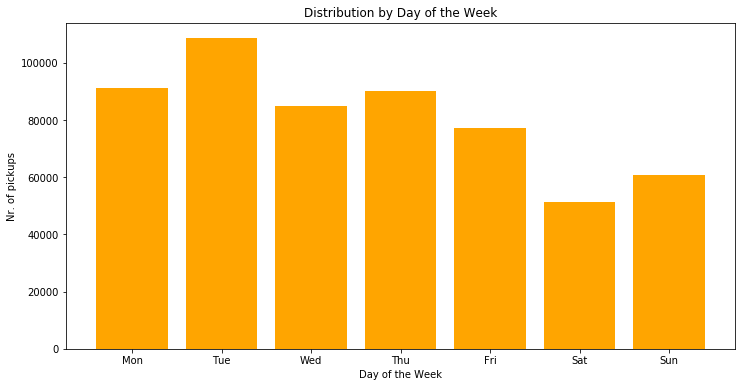

<IPython.core.display.Javascript object>

In [12]:
plt.figure(figsize=(12, 6))
# plt.hist(df.weekday, bins=7, range=(-0.5, 6.5), rwidth=0.8, color="green")
plt.hist(uber_apr.weekday, bins=7, range=(-0.5, 6.5), rwidth=0.8, color="orange")
plt.xticks(range(7), "Mon Tue Wed Thu Fri Sat Sun".split())
plt.xlabel("Day of the Week")
plt.ylabel("Nr. of pickups")
plt.title("Distribution by Day of the Week")

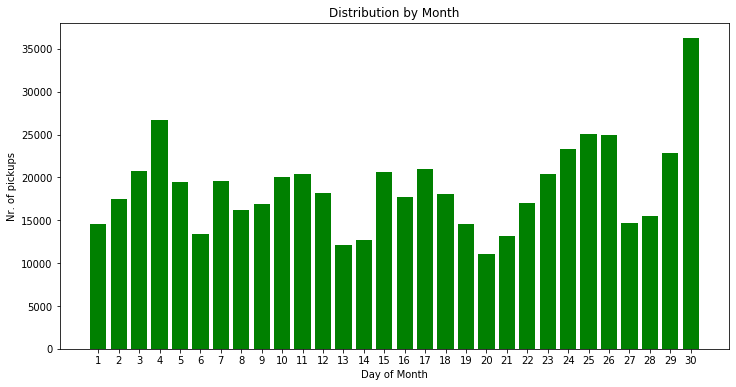

<IPython.core.display.Javascript object>

In [13]:
by_date = uber_apr.groupby("month_day").apply(lambda x: len(x))

plt.figure(figsize=(12, 6))
plt.bar(range(1, 31), by_date, color="green")
plt.xticks(range(1, 31), by_date.index)
plt.xlabel("Day of Month")
plt.ylabel("Nr. of pickups")
plt.title("Distribution by Month")
plt.show()

The most pickups where at the end of April.

Text(0.5, 1.0, 'Distribution by Hour')

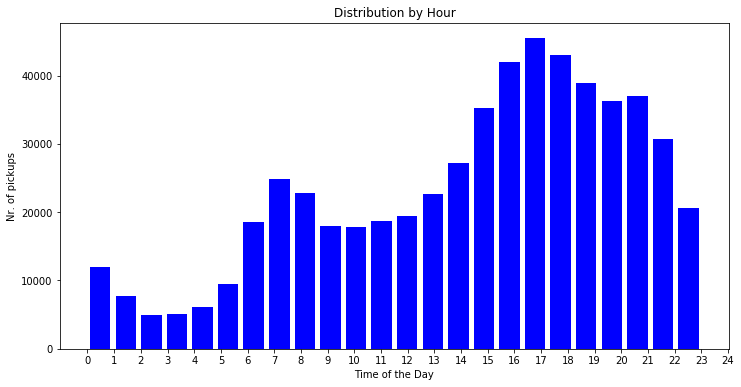

<IPython.core.display.Javascript object>

In [14]:
plt.figure(figsize=(12, 6))
# plt.hist(df.hour, bins=24, range=(0, 25), rwidth=0.8)
plt.hist(uber_apr.hour, bins=24, rwidth=0.8, color="blue")
plt.xticks(range(0, 25), uber_apr.hour.index)
plt.xlabel("Time of the Day")
plt.ylabel("Nr. of pickups")
plt.title("Distribution by Hour")

During the month of April, the most pickups are between 3pm and 10pm.

In [15]:
# Display pickups by Base
# plt.figure(figsize=(20, 15))
# sns.scatterplot(x=df.Lat, y=df.Lon, hue=df.Base)

<IPython.core.display.Javascript object>

In [16]:
px.scatter_mapbox(
    uber_apr,
    lat="Lat",
    lon="Lon",
    color="Base",
    zoom=7,
    mapbox_style="carto-positron",
    #    mapbox_style="carto-darkmatter",
    title="All pickup points from April 2014 by Base",
)

<IPython.core.display.Javascript object>

In [17]:
bases_df = pd.read_excel("data/bases1.xls")
bases_df

,Base Code,Base name,Lat,Lon
0,B02512,Unter,40.74844,-73.93946
1,B02617,Weiter,40.75273,-74.00641
2,B02682,Schmecken,40.74844,-73.93946
3,B02764,Danach-NY,40.74844,-73.93946
4,B02765,Grun,40.74844,-73.93946
5,B02835,Dreist,40.74844,-73.93946
6,B02836,Drinnen,40.74844,-73.93946


<IPython.core.display.Javascript object>

## Analysis

The almost 600,000 data points analysis is too heavy even for a 40GB RAM machine so I need to take a sample of the data

### Data sample and all features analysis: Lon, Lat, month_day, week_day, hour

In [18]:
# sample = uber_apr.sample(20000)
# uber_sample = sample.loc[:, ["Lon", "Lat", "month_day", "week_day", "hour", "minute"]]
# no real info from minute
# uber_sample

uber_sample = uber_apr.sample(20000).loc[
    :, ["Lon", "Lat", "month_day", "week_day", "hour"]
]
uber_sample.head()

,Lon,Lat,month_day,week_day,hour
115807,-74.0053,40.7388,16,2,16
342688,-73.9954,40.7444,3,3,10
267373,-73.9789,40.6661,14,0,13
90506,-73.9831,40.7715,11,4,18
67770,-74.0575,40.7326,7,0,14


<IPython.core.display.Javascript object>

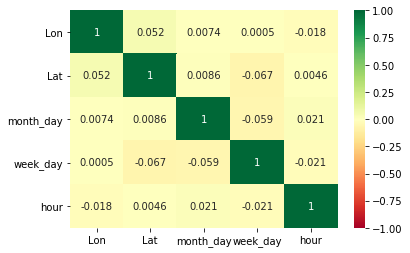

<IPython.core.display.Javascript object>

In [19]:
# no strong correlation between features
sns.heatmap(uber_sample.corr(), cmap="RdYlGn", annot=True, vmin=-1, vmax=1)
plt.show()

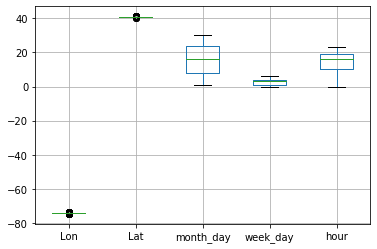

<IPython.core.display.Javascript object>

In [20]:
uber_sample.boxplot()
plt.show()

In [21]:
# Scale the data
scaler = StandardScaler()
scaled = scaler.fit_transform(uber_sample)
scaled_df = pd.DataFrame(scaled, columns=uber_sample.columns)
scaled_df.head()

,Lon,Lat,month_day,week_day,hour
0,-0.554341,-0.039620,-0.010199,-0.470523,0.264638
1,-0.359959,0.116512,-1.440497,0.076438,-0.756145
2,-0.035990,-2.066553,-0.230245,-1.564446,-0.245753
3,-0.118455,0.872081,-0.560314,0.623399,0.604899
4,-1.579261,-0.212481,-1.000405,-1.564446,-0.075623


<IPython.core.display.Javascript object>

###### K-MEANS

In [22]:
# Select no of clusters k=5(guess based on the number of Bases, 5)
kmeans = KMeans(n_clusters=5)
kmeans.fit(scaled_df)
# uber_scaled["Kmeans_cluster"] = kmeans.predict(uber_scaled)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=5, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

<IPython.core.display.Javascript object>

In [23]:
# Unscale the clst.cluster_centers_ using your StandardScaler instance.
# centroids = scaler.inverse_transform(kmeans.cluster_centers_)

# Save the unscaled centroids to a dataframe with the same names as the startup dataframe
# centroids_df = pd.DataFrame(centroids, columns=uber_sample.columns)
# centroids_df.style.background_gradient()


# NO INTERESTING OBSERVATIONS FROM THE CENTROIDS OF THE CLUSTERS

<IPython.core.display.Javascript object>

In [24]:
labeled_X = uber_sample.copy()
labeled_X["label"] = kmeans.labels_
labeled_X["label"] = "Cluster: " + labeled_X["label"].astype(str)

clst_avgs = labeled_X.groupby("label").mean()
clst_avgs = clst_avgs.sort_values(clst_avgs.columns[0])
clst_avgs.style.background_gradient()

,Lon,Lat,month_day,week_day,hour
label,,,,,
Cluster: 3,-73.987634,40.736602,16.371002,4.568763,18.383085
Cluster: 0,-73.982392,40.734468,14.926822,4.058773,5.955920
Cluster: 1,-73.980681,40.747436,26.271508,1.410775,15.010434
Cluster: 2,-73.980184,40.748226,8.062942,1.617397,15.224540
Cluster: 4,-73.772046,40.669513,16.269581,2.970856,14.859745


<IPython.core.display.Javascript object>

Cluster 3: heavy on pickups during weekeend evenigns, midle of the month

Cluster 0: heavy on pickups at the of the month, light at beginning of week, moderate trafic afternoon

Cluster 4: moderate pickups mid-month, mid-week

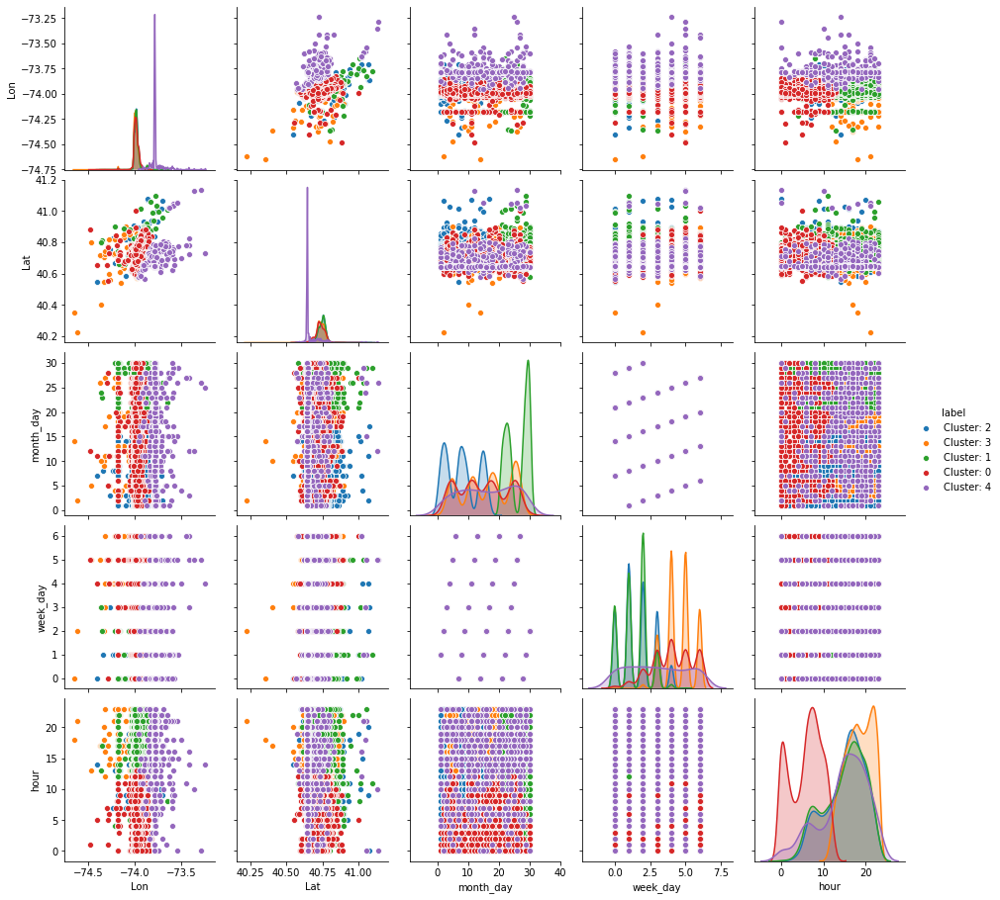

<IPython.core.display.Javascript object>

In [25]:
# pairplot colored by cluster
sns.pairplot(labeled_X, hue="label")
plt.show()

### Data sample and geolocation only

In [26]:
# we only have the geolocation data so there is no need to scale the data
# However,we need to sample the data since compter it's crashing for the raw data
uber_sample_gl = uber_apr.sample(20000)
X = uber_sample_gl.loc[:, ["Lon", "Lat"]]
X.head()

,Lon,Lat
73419,-73.9906,40.7037
153248,-73.9889,40.7439
375614,-73.9948,40.7249
45366,-73.9903,40.7180
106774,-73.9414,40.7240


<IPython.core.display.Javascript object>

### Elbow method to determine n_clusters

Elbow Method is an empirical method to find the optimal number of clusters for a dataset. In this method, we pick a range of candidate values of k, then apply K-Means clustering using each of the values of k. Find the average distance of each point in a cluster to its centroid, and represent it in a plot. Pick the value of k, where the average distance falls suddenly.

In [27]:
range_n_clusters = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
avg_distance = []
for n_clusters in range_n_clusters:
    clusters = KMeans(n_clusters=n_clusters)
    clusters.fit(X)
    avg_distance.append(clusters.inertia_)

<IPython.core.display.Javascript object>

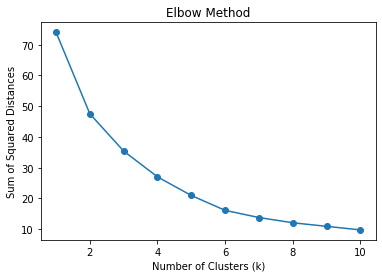

<IPython.core.display.Javascript object>

In [28]:
# import matplotlib.style as style

# style.use("fivethirtyeight")

plt.plot(range_n_clusters, avg_distance, marker="o")
plt.title("Elbow Method")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Sum of Squared Distances")
plt.show()

###### Can be any of  k=2,3,4,5,6 so will try the silhouette method to find the best number of clusters

### Silhouette method to determine n_clusters

In [29]:
silhouette_list_kmeans = []
for i in range(2, 10):
    kmeans_dataset_silhouette = KMeans(n_clusters=i, n_jobs=-1)
    kmeans_dataset_silhouette.fit(X)
    silhouette_list_kmeans.append(
        silhouette_score(X, kmeans_dataset_silhouette.labels_)
    )

<IPython.core.display.Javascript object>

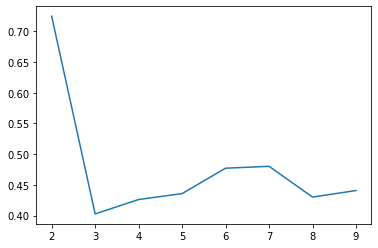

<IPython.core.display.Javascript object>

In [30]:
sns.lineplot(range(2, 10), silhouette_list_kmeans)

In [31]:
index_best_nb_clusters_silhouette = np.where(
    silhouette_list_kmeans[1:10] == max(silhouette_list_kmeans[1:10])
)

# I add 2 because :
# - silhouette_list begins at 2 clusters

best_n_clusters_silhouette = index_best_nb_clusters_silhouette[0][0] + 2
best_n_clusters_silhouette

6

<IPython.core.display.Javascript object>

In [32]:
# k=6 clusters gives the best silhouette_score
from sklearn import datasets, metrics

labels = KMeans(n_clusters=6).fit_predict(X)
print(metrics.silhouette_score(X, labels, metric="euclidean"))

0.4772528352500397


<IPython.core.display.Javascript object>

###### The silhouette method indicates that k=6 cluster is the magic number

### K-MEANS

In [33]:
# Run K-means clustering with K = 6
kmeans = KMeans(n_clusters=6)
kmeans.fit(X)
uber_sample_gl["Kmeans_cluster"] = kmeans.predict(X)
uber_sample_gl.head()

,Date/Time,Lat,Lon,Base,month_day,weekday,week_day,hour,minute,Kmeans_cluster
73419,2014-04-08 15:32:00,40.7037,-73.9906,Hinter,8,Tuesday,1,15,32,5
153248,2014-04-23 12:34:00,40.7439,-73.9889,Hinter,23,Wednesday,2,12,34,5
375614,2014-04-06 21:42:00,40.7249,-73.9948,Schmecken,6,Sunday,6,21,42,5
45366,2014-04-03 12:54:00,40.7180,-73.9903,Hinter,3,Thursday,3,12,54,5
106774,2014-04-15 05:29:00,40.7240,-73.9414,Hinter,15,Tuesday,1,5,29,2


<IPython.core.display.Javascript object>

In [34]:
pd.Series(kmeans.labels_).value_counts()

5    8910
0    7646
2    2116
3     685
1     468
4     175
dtype: int64

<IPython.core.display.Javascript object>

In [35]:
centroids = kmeans.cluster_centers_
centroids

array([[-73.97264232,  40.76555202],
       [-73.77443568,  40.65907308],
       [-73.9649965 ,  40.68773817],
       [-73.87226496,  40.79365241],
       [-74.21283486,  40.69925257],
       [-73.9986124 ,  40.73072712]])

<IPython.core.display.Javascript object>

In [36]:
clocation_df = pd.DataFrame(centroids)
clocation = clocation_df.rename(columns={0: "Lon", 1: "Lat"})
clocation

,Lon,Lat
0,-73.972642,40.765552
1,-73.774436,40.659073
2,-73.964997,40.687738
3,-73.872265,40.793652
4,-74.212835,40.699253
5,-73.998612,40.730727


<IPython.core.display.Javascript object>

/Users/cri/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: MatplotlibDeprecationWarning:

Support for uppercase single-letter colors is deprecated since Matplotlib 3.1 and will be removed in 3.3; please use lowercase instead.



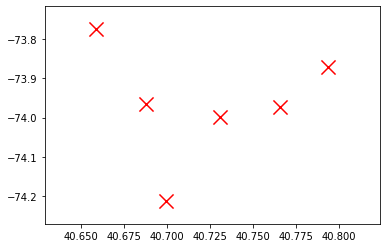

<IPython.core.display.Javascript object>

In [37]:
# Visualizing the centroids
plt.scatter(clocation["Lat"], clocation["Lon"], marker="x", color="R", s=200)
plt.show()

In [38]:
px.scatter_mapbox(
    clocation,
    lat="Lat",
    lon="Lon",
    #    color="R",
    zoom=9,
    size="Lat",
    #  mapbox_style="carto-darkmatter",
    mapbox_style="carto-positron",
    title="Centroids locations",
)

<IPython.core.display.Javascript object>

In [39]:
px.scatter_mapbox(
    uber_sample_gl,
    lat="Lat",
    lon="Lon",
    color="Kmeans_cluster",
    zoom=8,
    mapbox_style="carto-positron",
    #    mapbox_style = open-street-map,
    #    mapbox_style="carto-darkmatter",
    title="Clustering sample points from April 2014 with Kmeans k=6",
)

<IPython.core.display.Javascript object>

## DBSCAN

In [40]:
# We take an eps = 0.015 to have a reasonable number of clusters
dbscan = DBSCAN(eps=0.015, min_samples=100)
# eps is the most important DBSCAN parameter. It represent the maximum distance between two samples for one to be considered as in the neighborhood of the other (source : sklearn.cluster.DBSCAN).
# The second most important DBSCAN parameter is min_sample. This parameter determines the minimum number of points required to form a cluster. Without giving min_samples, sklearn automatically gives 5.
uber_sample_gl["dbscan_cluster"] = dbscan.fit_predict(X)

<IPython.core.display.Javascript object>

In [41]:
uber_sample_gl["dbscan_cluster"].unique()

array([ 0,  1, -1,  2,  3,  4])

<IPython.core.display.Javascript object>

### The model automatically generated 8 clusters, distributed according to the density of the points on the map.
#### Now, we separate the data in according to the value time (like with Kmeans)

In [42]:
uber_sample_gl.head()

,Date/Time,Lat,Lon,Base,month_day,weekday,week_day,hour,minute,Kmeans_cluster,dbscan_cluster
73419,2014-04-08 15:32:00,40.7037,-73.9906,Hinter,8,Tuesday,1,15,32,5,0
153248,2014-04-23 12:34:00,40.7439,-73.9889,Hinter,23,Wednesday,2,12,34,5,0
375614,2014-04-06 21:42:00,40.7249,-73.9948,Schmecken,6,Sunday,6,21,42,5,0
45366,2014-04-03 12:54:00,40.7180,-73.9903,Hinter,3,Thursday,3,12,54,5,0
106774,2014-04-15 05:29:00,40.7240,-73.9414,Hinter,15,Tuesday,1,5,29,2,0


<IPython.core.display.Javascript object>

In [43]:
px.scatter_mapbox(
    uber_sample_gl,
    lat="Lat",
    lon="Lon",
    color="dbscan_cluster",
    zoom=8,
    mapbox_style="carto-positron",
    #    mapbox_style = open-street-map,
    #    mapbox_style="carto-darkmatter",
    title="Clustering sample points from April 2014 with DBSCAN k=5",
)

<IPython.core.display.Javascript object>

In [44]:
uber_sample_gl["dbscan_cluster"].value_counts()

 0    18230
-1      811
 1      409
 3      386
 2      118
 4       46
Name: dbscan_cluster, dtype: int64

<IPython.core.display.Javascript object>

cluster "-1" represents the outliers

In [45]:
# Hourly distribution
result_hour = uber_sample_gl.sort_values("hour")

<IPython.core.display.Javascript object>

In [46]:
px.scatter_mapbox(
    result_hour,
    lat="Lat",
    lon="Lon",
    color="dbscan_cluster",
    animation_frame="hour",
    zoom=8,
    mapbox_style="carto-positron",
    #    mapbox_style = open-street-map,
    #    mapbox_style="carto-darkmatter",
    title="Evolution (hour of day) of clustering with DBSCAN k=5",
)

<IPython.core.display.Javascript object>

Same as hourly distribution can be run for day of the week & day of the month

### Conclusion

Both clustering methods show improved pickups allocation than existing one. <b>DBSCAN</b> is more suitable for geolocation clustering and seems to be a better model making possible to group points in space more easily according to their densities. Depending on the location of the points, this model is able to group them together and thus obtain a specific cluster. <b>Kmeans</b> will be more suitable for data grouped in the shape of a ball. If our data were significantly separated in a circle, the Kmeans model would be more suitable.